In [20]:
!pip install folium

In [21]:
# imports
from google.datalab import Context
import google.datalab.bigquery as bq
import google.datalab.storage as storage
import pandas as pd
import pandas.io.formats.style
import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
import folium 
from folium import plugins

%matplotlib inline

try:
    from StringIO import StringIO
except ImportError:
    from io import BytesIO as StringIO


In [22]:
%%gcs read --object gs://ucsb_hacks_datasets/sf_crime_data_latest_2.csv 	--variable crime_data

# Crime in San Francisco - Analysis with BigQuery, G Compute, Cloud Datalab

## Dataset Size
**2.2 million records** over **16 years** time period from **2003**.

In [23]:
df = pd.read_csv(StringIO(crime_data))
df.head()

,unique_key,category,dayofweek,pddistrict,resolution,latitude,longitude,timestamp
0,141066309,NON-CRIMINAL,Friday,PARK,UNFOUNDED,37.782371,-122.448043,2014-12-19 17:16:00
1,150091656,ASSAULT,Friday,PARK,NONE,37.780849,-122.436443,2015-01-30 04:15:00
2,140278814,FRAUD,Friday,PARK,"ARREST, BOOKED",37.775802,-122.446473,2014-04-04 00:43:00
3,140259999,OTHER OFFENSES,Friday,PARK,NONE,37.772899,-122.435591,2014-03-28 10:12:00
4,140813523,RUNAWAY,Friday,PARK,LOCATED,37.771727,-122.441394,2014-09-26 19:00:00


## What SF district has the most number of crimes?
The bar chart below excludes misdemeanor crimes.


In [24]:
# Group data by districts 
df_violent_crime = df[df.category != "NON-CRIMINAL"] # Find all crime records that can be classified as violent 
df_violent_crime_by_district = df_violent_crime.groupby(['pddistrict']).size().\
                                                reset_index(name='counts').\
                                                sort_values('counts', ascending=False)


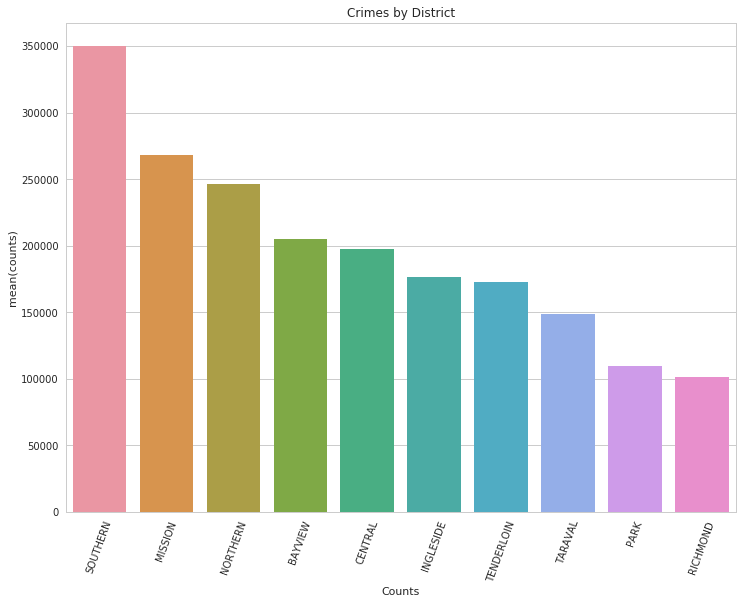

In [25]:
import warnings
warnings.filterwarnings('ignore')
sns.barplot(x='pddistrict', y='counts', data=df_violent_crime_by_district)
sns.set(style="whitegrid")
plt.gcf().set_size_inches(12, 9)
plt.xlabel('Counts')
plt.xticks(rotation=70)
plt.title('Crimes by District')
plt.show()

In [26]:
%%gcs read --object gs://ucsb_hacks_datasets/sfpddistricts.geojson.txt  	    --variable district_geo

## Number of Incidents Per District

In [27]:
# creation of the choropleth
choroplethMap = folium.Map(location=[37.774929, -122.419416], zoom_start=13)
df_violent_crime_by_district.to_json('crimeagg.json')

# district_geo = r'sfpddistricts.geojson'
folium.Choropleth(
    geo_data=district_geo,
    name='choropleth',
    data_out='crimeagg.json',
    data=df_violent_crime_by_district,
    columns=['pddistrict', 'counts'],
    key_on='feature.properties.DISTRICT',
     fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Number of Incidents Per District'
).add_to(choroplethMap)

choroplethMap

## Does crime happen more often on one day of another?
Actually, **NO**!

In [28]:
df_violent_crime_by_day = df_violent_crime.groupby(['dayofweek']).size().\
                                                reset_index(name='counts').\
                                                sort_values('counts', ascending=False)

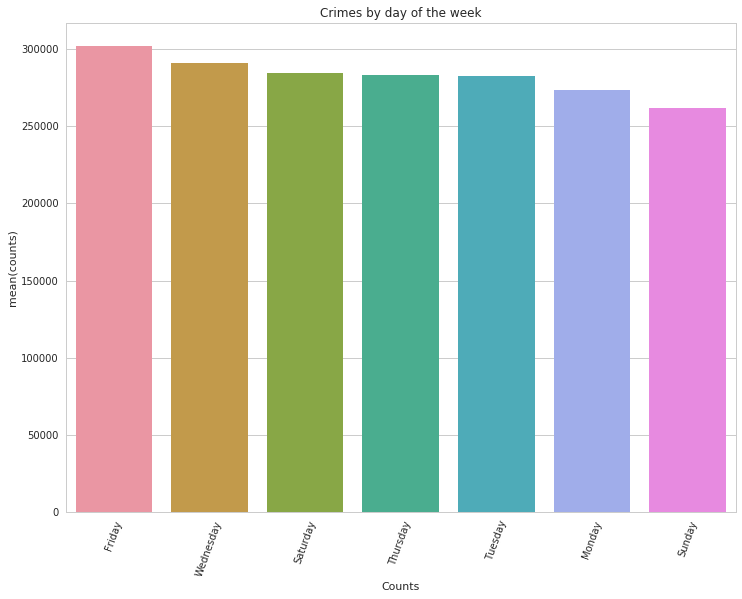

In [29]:
sns.barplot(x='dayofweek', y='counts', data=df_violent_crime_by_day)
sns.set(style="whitegrid")
plt.gcf().set_size_inches(12, 9)
plt.xlabel('Counts')
plt.xticks(rotation=70)
plt.title('Crimes by day of the week')
plt.show()

## HeatMap of Crime in 2018

In [34]:
t_df = df[['latitude', 'longitude', 'timestamp']].copy()
t_df['timestamp'] = pd.to_datetime(t_df['timestamp'])
new_df = t_df[t_df['timestamp'].dt.year == 2018]

In [35]:
test_df = new_df[['latitude', 'longitude']]

crime_map = folium.Map([37.774929, -122.419416], zoom_start=12)

for tupe in test_df.itertuples():
    folium.CircleMarker([tupe[1], tupe[2]],
                        radius=15,
#                         popup=row['unique_key'],
                        fill_color="#c10000", # divvy color
                       ).add_to(crime_map)
    
# convert to (n, 2) nd-array format for heatmap
crime_coordinates_df = test_df[['latitude', 'longitude']].as_matrix()

# plot heatmap
crime_map.add_child(plugins.HeatMap(crime_coordinates_df, radius=15))
crime_map